# Anticipez les besoins en consommation de bâtiments
## Analyse exploratoire

- Ce NoteBook est composé de :
    - 1/ Importation des données

    - 2/ Overview de la qualité de données 
        - A) Erreurs de type    
        - B) Données manquantes 
        - C) Doublons 
        - D) Outliers 

    - 3/ Préparation des données 
        - A) Sélection des bâtiments non résidentiels
        - B) Gestion des outliers & état de conformité

    - 4/ Analyse exploratoire des targets
        - A) Consommation énergétique
        - B) Emissions de gaz à effets de serre 

    - 5/ Analyse exploratoire des features
        - A) Données physiques : 
            - Architecture des bâtiments
            - Superficie
        - B)  Année de construction
        - C) Utilisation
        - D) Géographie
        - E)  Mix énergétique
        - F) EnergyStarScore

### 1/ Importation des données

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import folium
import branca.colormap as cm, LinearColormap

In [2]:
data = pd.read_csv('2016_Building_Energy_Benchmarking.csv')

In [3]:
data.head()

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,...,Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity
0,1,2016,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,...,1.156514e+06,3946027.0,12764.52930,1276453.0,False,NaN,Compliant,NaN,249.98,2.83
1,2,2016,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,...,9.504252e+05,3242851.0,51450.81641,5145082.0,False,NaN,Compliant,NaN,295.86,2.86
2,3,2016,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,...,1.451544e+07,49526664.0,14938.00000,1493800.0,False,NaN,Compliant,NaN,2089.28,2.19
3,5,2016,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,...,8.115253e+05,2768924.0,18112.13086,1811213.0,False,NaN,Compliant,NaN,286.43,4.67
4,8,2016,NonResidential,Hotel,WARWICK SEATTLE HOTEL (ID8),401 LENORA ST,Seattle,WA,98121.0,0659000970,...,1.573449e+06,5368607.0,88039.98438,8803998.0,False,NaN,Compliant,NaN,505.01,2.88


In [4]:
data.shape

(3376, 46)

Le jeu de données est composé de 3376 bâtiments et 46 variables. 

### 2/ Overview de la qualité des données

#### A) Erreurs de types 

In [5]:
data.dtypes
#OK

OSEBuildingID                        int64
DataYear                             int64
BuildingType                        object
PrimaryPropertyType                 object
PropertyName                        object
Address                             object
City                                object
State                               object
ZipCode                            float64
TaxParcelIdentificationNumber       object
CouncilDistrictCode                  int64
Neighborhood                        object
Latitude                           float64
Longitude                          float64
YearBuilt                            int64
NumberofBuildings                  float64
NumberofFloors                       int64
PropertyGFATotal                     int64
PropertyGFAParking                   int64
PropertyGFABuilding(s)               int64
ListOfAllPropertyUseTypes           object
LargestPropertyUseType              object
LargestPropertyUseTypeGFA          float64
SecondLarge

Il n'y a pas d'erreurs de type.

#### B) Données manquantes

In [6]:
data.isnull().sum()

OSEBuildingID                         0
DataYear                              0
BuildingType                          0
PrimaryPropertyType                   0
PropertyName                          0
Address                               0
City                                  0
State                                 0
ZipCode                              16
TaxParcelIdentificationNumber         0
CouncilDistrictCode                   0
Neighborhood                          0
Latitude                              0
Longitude                             0
YearBuilt                             0
NumberofBuildings                     8
NumberofFloors                        0
PropertyGFATotal                      0
PropertyGFAParking                    0
PropertyGFABuilding(s)                0
ListOfAllPropertyUseTypes             9
LargestPropertyUseType               20
LargestPropertyUseTypeGFA            20
SecondLargestPropertyUseType       1697
SecondLargestPropertyUseTypeGFA    1697


<Axes: >

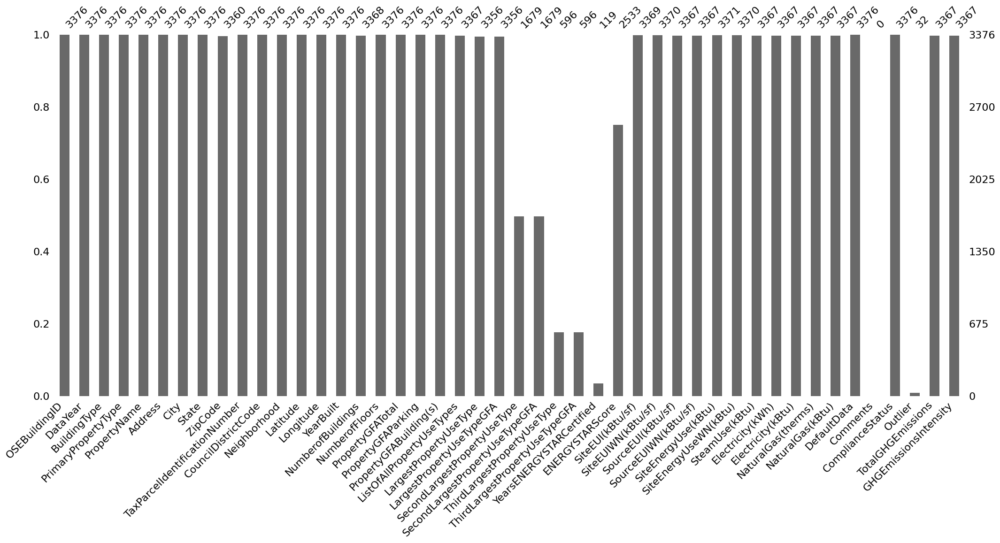

In [7]:
# Visualisation des données manquantes 
%matplotlib inline
# Configuration des paramètres par défaut
plt.rc('axes', grid=False)
msno.bar(data)

La donnée "default data" permet de déterminer si des données sont manquantes. En effet, il arrive parfois que les données manquantes soient représentées par des données nulles plutôt que par une véritable absence de données.
Par conséquent le traitement des données manquantes sera effectué après sélection des variables d'intérêts. 

#### C)  Doublons

In [8]:
data.duplicated().sum()
# OK

0

Il n'existe pas de doublons dans le jeu de données. 

#### D) Outliers

In [9]:
data.describe()

,OSEBuildingID,DataYear,ZipCode,CouncilDistrictCode,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,...,SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),Comments,TotalGHGEmissions,GHGEmissionsIntensity
count,3376.000000,3376.0,3360.000000,3376.000000,3376.000000,3376.000000,3376.000000,3368.000000,3376.000000,3.376000e+03,...,3.371000e+03,3.370000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,0.0,3367.000000,3367.000000
mean,21208.991114,2016.0,98116.949107,4.439277,47.624033,-122.334795,1968.573164,1.106888,4.709123,9.483354e+04,...,5.403667e+06,5.276726e+06,2.745959e+05,1.086639e+06,3.707612e+06,1.368505e+04,1.368505e+06,NaN,119.723971,1.175916
std,12223.757015,0.0,18.615205,2.120625,0.047758,0.027203,33.088156,2.108402,5.494465,2.188376e+05,...,2.161063e+07,1.593879e+07,3.912173e+06,4.352478e+06,1.485066e+07,6.709781e+04,6.709781e+06,NaN,538.832227,1.821452
min,1.000000,2016.0,98006.000000,1.000000,47.499170,-122.414250,1900.000000,0.000000,0.000000,1.128500e+04,...,0.000000e+00,0.000000e+00,0.000000e+00,-3.382680e+04,-1.154170e+05,0.000000e+00,0.000000e+00,NaN,-0.800000,-0.020000
25%,19990.750000,2016.0,98105.000000,3.000000,47.599860,-122.350662,1948.000000,1.000000,2.000000,2.848700e+04,...,9.251286e+05,9.701822e+05,0.000000e+00,1.874229e+05,6.394870e+05,0.000000e+00,0.000000e+00,NaN,9.495000,0.210000
50%,23112.000000,2016.0,98115.000000,4.000000,47.618675,-122.332495,1975.000000,1.000000,4.000000,4.417500e+04,...,1.803753e+06,1.904452e+06,0.000000e+00,3.451299e+05,1.177583e+06,3.237538e+03,3.237540e+05,NaN,33.920000,0.610000
75%,25994.250000,2016.0,98122.000000,7.000000,47.657115,-122.319407,1997.000000,1.000000,5.000000,9.099200e+04,...,4.222455e+06,4.381429e+06,0.000000e+00,8.293178e+05,2.829632e+06,1.189033e+04,1.189034e+06,NaN,93.940000,1.370000
max,50226.000000,2016.0,98272.000000,7.000000,47.733870,-122.220966,2015.000000,111.000000,99.000000,9.320156e+06,...,8.739237e+08,4.716139e+08,1.349435e+08,1.925775e+08,6.570744e+08,2.979090e+06,2.979090e+08,NaN,16870.980000,34.090000


In [10]:
data['Outlier'].value_counts()

Outlier
Low outlier     23
High outlier     9
Name: count, dtype: int64

Il existe une variable 'Outlier' qui traite la présence de bâtiments avec des caractéristiques abbérantes. Les bâtiments qui sont des des 'Low outlier' et des 'High outlier' seront supprimés par la suite.  

### 3) Préparation des données

#### A) Sélection des bâtiments non résidentiels

L'étude se concentre sur la consommation et les émissions des bâtiments non destinés à l’habitation. Par conséquent il est nécessaire de sélectionner uniquement ce type de bâtiment.

In [13]:
data['BuildingType'].value_counts()

BuildingType
NonResidential          1460
Multifamily LR (1-4)    1018
Multifamily MR (5-9)     580
Multifamily HR (10+)     110
SPS-District K-12         98
Nonresidential COS        85
Campus                    24
Nonresidential WA          1
Name: count, dtype: int64

Les bâtiments dont le 'BuildingType' est 'non résidentiel' sont sélectionnés, c'est à dire : 
- 'NonResidential' ; 
- 'Nonresidential WA' ; , 
- 'Nonresidential COS'.

In [14]:
# selection uniquement des types de buildings Non Résidentiels
data_extract = data.loc[(data['BuildingType'] == 'NonResidential') |
                        (data['BuildingType'] == 'Nonresidential WA') |
                        (data['BuildingType'] == 'Nonresidential COS'),:]
data_extract.shape
# OK

(1546, 46)

In [15]:
# vérification que les bâtiments sont des bâtiments non résidentiels 
data_extract['LargestPropertyUseType'].value_counts()

LargestPropertyUseType
Office                                                  495
Non-Refrigerated Warehouse                              199
Retail Store                                             97
Other                                                    91
Hotel                                                    76
Worship Facility                                         71
Distribution Center                                      54
Supermarket/Grocery Store                                41
Medical Office                                           41
K-12 School                                              39
Other - Recreation                                       31
Parking                                                  29
Self-Storage Facility                                    27
Residence Hall/Dormitory                                 22
Other - Entertainment/Public Assembly                    21
Senior Care Community                                    20
College/Universit

Il est vérifié si les bâtiments sont classés comme des bâtiments non résidentiels dans 'LargestPropertyUseType'. Les bâtiments qui ne semblent pas correspondre à une catégorie non résidentiels dans "LargestPropertyUseType" sont supprimés.

In [16]:
data_a_sup =['Other - Lodging/Residential', 
             'Residence Hall/Dormitory',
             'Residential Care Facility',
             'Multifamily Housing']
mask = data_extract['LargestPropertyUseType'].isin(data_a_sup)
data_extract = data_extract.drop(data_extract[mask].index)

In [17]:
data_extract.shape

(1507, 46)

A la suite de la sélection des batiments non résidentiels, il reste 1505 bâtiments pour l'analyse.

#### B) Gestion des outliers & état de conformité

In [18]:
data_extract['Outlier'].value_counts()

Outlier
Low outlier     13
High outlier     2
Name: count, dtype: int64

In [19]:
data_extract.loc[data_extract['Outlier'] == 'High outlier',:]

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,...,Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity
226,350,2016,NonResidential,Large Office,Second And Spring Building,1100 Second Avenue,Seattle,WA,98101.0,0942000045,...,11663150.0,39794668.0,16048.30957,1604831.0,False,NaN,Non-Compliant,High outlier,362.66,2.10
517,704,2016,NonResidential,Large Office,401 Elliott Ave West,401 Elliot Ave West,Seattle,WA,98119.0,7666202110,...,7953454.5,27137187.0,0.00000,0.0,False,NaN,Non-Compliant,High outlier,189.18,1.46


In [20]:
data_extract.loc[data_extract['Outlier'] == 'Low outlier',:]

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,...,Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity
384,539,2016,NonResidential,Retail Store,University Center,4501 Roosevelt Way NE,Seattle,WA,98105.0,5335200380,...,93482.601560,318963.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,2.22,0.03
448,608,2016,NonResidential,Large Office,411 1ST AVE S (ID608),411 1ST AVE S,Seattle,WA,98104.0,5247800200,...,471503.000000,1608768.0,3430.500488,343050.0,False,NaN,Non-Compliant,Low outlier,29.43,0.19
1045,20617,2016,NonResidential,Retail Store,Seattle Habitat Store,21 S Nevada St,Seattle,WA,98134.0,1824049074,...,14362.500000,49005.0,964.640015,96464.0,True,NaN,Error - Correct Default Data,Low outlier,5.46,0.14
1229,21315,2016,NonResidential,Small- and Mid-Sized Office,1518 Fifith Ave,1520 Fifth Ave,Seattle,WA,98101.0,1975700135,...,7064.899902,24105.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,0.17,0.00
1295,21474,2016,NonResidential,Other,The Lusty Lady,1315 1st Ave,Seattle,WA,98101.0,1976200060,...,12981.700200,44294.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,0.31,0.01
1611,22830,2016,NonResidential,Worship Facility,Freedom Church,9601 35th Ave,Seattle,WA,98126.0,2858600090,...,29555.000000,100842.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,0.70,0.03
1945,23912,2016,NonResidential,Small- and Mid-Sized Office,1416 S Jackson,1416 South Jackson Street,Seattle,WA,98133.0,3320000165,...,41554.601560,141784.0,1430.729858,143073.0,False,NaN,Non-Compliant,Low outlier,8.59,0.19
2129,24547,2016,NonResidential,K-12 School,Islamic School of Seattle,720 25TH AVE,Seattle,WA,98122.0,6840700175,...,47292.898440,161363.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,1.12,0.05
2189,24717,2016,NonResidential,Other,1701 First Ave South LLC,1701 First Ave South,Seattle,WA,98134.0,7666207085,...,4926.399902,16809.0,0.000000,0.0,False,NaN,Non-Compliant,Low outlier,0.12,0.00
2216,24825,2016,NonResidential,Small- and Mid-Sized Office,2233 Building,2233 1st AVE.South,Seattle,WA,98104.0,7666207190,...,34489.898440,117680.0,868.193909,86819.0,False,NaN,Non-Compliant,Low outlier,5.43,0.26


Les bâtiments ayant un statut 'High outlier' ou 'Low outlier' sont supprimées car il y a peu de bâtiments et il n'y a pas suffisamment d'informations sur la différence entre les deux types pour les distinguer.

In [21]:
data_extract = data_extract.drop(data_extract.loc[(data_extract['Outlier']=='High outlier') |
                                                  (data_extract['Outlier']=='Low outlier')].index)
data_extract.shape
# OK 

(1492, 46)

Il existe également des informations concernant le statut de conformité qui indique si une propriété a satisfait aux exigences de référencement énergétique pour l'année de déclaration en cours. Par précaution les bâtiments 'non compliant' sont supprimés de l'analyse. 

In [22]:
data_extract['ComplianceStatus'].value_counts()

ComplianceStatus
Compliant                       1476
Error - Correct Default Data      12
Non-Compliant                      3
Missing Data                       1
Name: count, dtype: int64

In [23]:
data_extract = data_extract.loc[data_extract['ComplianceStatus']=='Compliant']
data_extract.shape

(1476, 46)

In [24]:
data_extract.to_csv('data_extract.csv', index=False)

A la suite de l'analyse des outliers et des statuts de conformité, il reste 1476 bâtiments pour l'analyse. 

### 4) Analyse exploratoire des targets

#### A) Consommation énergétique

Les variables disponibles pour la target sont :
- 'SiteEUI(kBtu/sf)'
- 'SiteEUIWN(kBtu/sf)'
- 'SiteEUI(kBtu/sf)'
- 'SourceEUIWN(kBtu/sf)'
- 'SiteEnergyUse(kBtu)'
- 'SiteEnergyUseWN(kBtu)'
- 'SteamUse(kBtu)',
- 'Electricity(kWh)', 
- 'Electricity(kBtu)',
- 'NaturalGas(therms)', 
- 'NaturalGas(kBtu)'


Les deux types de variables sélectionées pour la target de consommation d'énergie sont : 
- La consommation surfacique : 'SiteEUI(kBtu/sf)'; 
- La consommation totale : 'SiteEnergyUse(kBtu)'.

L'hypothèse selon laquelle la prise en compte de la météo avec la variable 'SiteEUIWN(kBtu/sf)' n'est pas pertinente dans ce cas est adopté, étant donné que l'analyse se limite à la ville de Seattle où les conditions météorologiques sont considérées comme constantes.

Concernant la consommation d'énergie totale du site, cela correspond à la quantité annuelle d'énergie consommée par la propriété provenant de toutes les sources d'énergie. La consommation totale énergétique possède les avantages suivants :
- Mesure de la consommation réelle : La consommation énergétique totale représente la quantité absolue d'énergie utilisée par un bâtiment. En étudiant cette mesure, on obtient une estimation précise de la consommation énergétique réelle, ce qui peut être important pour des analyses telles que la planification budgétaire ou la gestion de l'approvisionnement en énergie.
- Pertinence pour les objectifs de réduction : Lorsqu'il s'agit de réduire la consommation énergétique globale et les émissions de carbone, la consommation totale est une métrique clé. En analysant cette mesure, on peut identifier les bâtiments ou les secteurs qui ont le plus fort impact et concentrer les efforts de réduction sur eux.
- Comparaison entre les périodes ou les bâtiments : La consommation énergétique totale permet de comparer la performance énergétique entre différentes périodes de temps ou entre différents bâtiments sans normalisation. Cela peut être utile pour évaluer les progrès réalisés dans l'efficacité énergétique, identifier les écarts de consommation entre les bâtiments et déterminer les facteurs influençant la consommation globale.
- Base de calcul pour les coûts énergétiques : La consommation énergétique totale est souvent utilisée pour calculer les coûts énergétiques d'un bâtiment. En comprenant cette mesure, on peut évaluer les dépenses liées à l'énergie et prendre des décisions éclairées sur les mesures d'efficacité énergétique à mettre en œuvre.

Concernant la consommation surfacique du site, cela correspond à la consommation d'énergie du site d'un bien immobilier divisée par sa surface brute de plancher. La consommation d'énergie du site est la quantité annuelle de toute l'énergie consommée par le bien sur place, telle qu'elle apparaît sur les factures des services publics. L'IUE du site est mesuré en milliers d'unités thermiques britanniques (kBtu) par pied carré. Cette mesure présente les avantages suivants : 
 - Normalisation de la taille des bâtiments : En utilisant l'intensité énergétique en fonction de la surface, on tient compte de la taille des bâtiments. Cela permet de comparer l'efficacité énergétique entre des bâtiments de différentes tailles et d'identifier ceux qui sont plus performants en termes d'utilisation de l'énergie.
 - Comparabilité entre les bâtiments : En normalisant la consommation énergétique par la surface, on élimine en partie les variations dues à la taille des bâtiments. Cela permet de comparer plus équitablement la performance énergétique de différents bâtiments, qu'ils soient grands ou petits.
 - Identification des incohérences ou des anomalies : Lorsque l'on étudie l'intensité énergétique en fonction de la surface, on peut repérer plus facilement les bâtiments qui consomment de manière disproportionnée par rapport à leur taille. Cela peut aider à identifier des incohérences ou des anomalies potentielles dans les données de consommation énergétique.

 Dans un premier temps la consommation totale sera étudiée puisque c'est l'indicateur que l'on cherche à prédire puis la consommation surfacique sera étudiée pour comparer les performances du modèle. 

Une analyse rapide de la target de consommation énergétique est réalisée ci-dessous : 

In [25]:
data_extract['SiteEnergyUse(kBtu)'].describe()

count    1.476000e+03
mean     7.823348e+06
std      1.900711e+07
min      5.713320e+04
25%      1.223105e+06
50%      2.687720e+06
75%      7.253381e+06
max      2.930908e+08
Name: SiteEnergyUse(kBtu), dtype: float64

In [26]:
data_extract['SiteEUI(kBtu/sf)'].describe()

count    1476.000000
mean       75.232995
std        76.241093
min         1.400000
25%        34.775000
50%        53.549999
75%        85.099998
max       834.400024
Name: SiteEUI(kBtu/sf), dtype: float64

In [27]:
indic_conso = ['SiteEnergyUse(kBtu)']

In [28]:
indic_conso_intensite =['SiteEUI(kBtu/sf)']

In [ ]:
def create_histogram_plot_log(data, x_label, y_label, title, x_log_scale=True):
    """
    Crée un graphique d'histogramme pour représenter la distribution des données.

    Args:
        data (list or array-like): Les données à représenter dans l'histogramme.
        x_label (str): Étiquette de l'axe des abscisses.
        y_label (str): Étiquette de l'axe des ordonnées.
        title (str): Titre du graphique.
        x_log_scale (bool): Si True, l'axe des abscisses sera à échelle logarithmique.

    Returns:
        None
    """
    plt.figure(figsize=(4, 3))
    
    # Création du graphique de la répartition de la variable
    sns.histplot(data)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)

    if x_log_scale:
        plt.xscale('log')

    %config InlineBackend.figure_format = 'retina'
    %config InlineBackend.figure.dpi = 300

    # Affiche le graphique
    plt.show()

In [ ]:
create_histogram_plot_log(data_extract[indic_conso],
                         'SiteEnergyUse(kBtu)',
                         'Compte',
                         'Répartition de la variable SiteEnergyUse(kBtu) (échelle logarithmique)')

La majorité des bâtiments ont une consommation énergétique comprise entre 0 et 1e6 kBtu. Il existe quelques bâtiments avec une consommation très supérieur à cela.

In [ ]:
create_histogram_plot_log(data_extract[indic_conso_intensite],
                         'SiteEnergyUse(kBtu/sf)',
                         'Compte',
                         'Répartition de la variable SiteEUI(kBtu/sf)')

La majorité des bâtiments ont une consommation énergétique surfacique comprise entre 0 et 200 kBtu/sf.

#### B) Emission de gaz à effet de serre

In [31]:
indic_GES = ['TotalGHGEmissions']

Les deux types de variables sélectionées pour la target des émissions de GES sont : 
- Les émissions totales : 'TotalGHGEmissions'.
- L'intensité des émissions : 'GHGEmissionsIntensity'; 

Concernant les émissions totale du site, cela correspond à la quantité totale d'émissions de gaz à effet de serre, y compris le dioxyde de carbone, le méthane et l'oxyde nitreux, rejetée dans l'atmosphère en raison de la consommation d'énergie du bien, mesurée en tonnes métriques d'équivalent dioxyde de carbone. Ce calcul utilise un facteur d'émissions de GES provenant du portefeuille de ressources de production de Seattle City Light. Il utilise le facteur d'émissions de 2015 de Seattle City Light, soit 52,44 livres de CO2e/MWh, jusqu'à ce que le facteur de 2016 soit disponible. Les avantages de cette target sont les suivants : 
- Evaluation globale des émissions : Un modèle de prédiction des émissions totales permet d'estimer l'empreinte carbone globale d'une activité ou d'une entité, en prenant en compte tous les facteurs qui contribuent aux émissions de GES. Cela peut être utile pour évaluer l'impact environnemental global et mesurer les progrès réalisés dans la réduction des émissions au fil du temps.
- Suivi des objectifs de réduction des émissions : Si l'objectif est de réduire les émissions totales de GES, un modèle de prédiction des émissions totales peut être plus approprié. Il permet de quantifier les émissions cibles à atteindre et de suivre les progrès réalisés vers ces objectifs.
- Comparaison avec les normes et réglementations : Les réglementations et normes en matière d'émissions de GES sont souvent définies en fonction des émissions totales. Un modèle de prédiction des émissions totales facilite la comparaison des performances d'une entité par rapport à ces normes et réglementations.

Concernant l'intensité des émissions du site, cela correspond au total des émissions de gaz à effet de serre divisé par la surface brute de plancher de la propriété, mesurée en kilogrammes d'équivalent de dioxyde de carbone par pied carré. Ce calcul utilise un facteur d'émissions de gaz à effet de serre provenant du portefeuille de ressources de production de Seattle City Light. Cette mesure présente les avantages suivants : 
- Pertinence pour l'évaluation de l'efficacité : Un modèle de prédiction des émissions de GES par surface peut être utile pour évaluer l'efficacité environnementale d'une activité ou d'une entité par rapport à la quantité d'émissions générées par unité de surface. Cela permet de comparer des entités de tailles différentes et de mettre en évidence les écarts de performance en termes d'utilisation des ressources et d'impact environnemental.
- Adaptabilité à différentes échelles : Ce type de modèle peut être utilisé à différentes échelles, que ce soit pour évaluer les émissions d'une entreprise spécifique, d'une ville ou d'une région. Il permet de prendre en compte la variabilité des caractéristiques spatiales et des pratiques environnementales.
- Aide à la planification urbaine durable : En utilisant un modèle de prédiction des émissions de GES par surface, il est possible d'estimer les émissions futures en fonction des plans d'aménagement urbain et des projets de développement. Cela permet de prendre des décisions plus éclairées pour favoriser la durabilité et la réduction des émissions à l'échelle de l'aménagement urbain.


Pour le cas spécifique, s'intéresser aux émissions de gaz à effet de serre total (GES) des bâtiments non résidentiels à Seattle serait plus approprié de suivre les émissions totales plutôt que les émissions par unité de surface. Voici quelques raisons qui justifient ce choix :
- Compréhension complète de l'impact global : En suivant les émissions totales des bâtiments non résidentiels, une vision complète de l'impact global de ces bâtiments sur les émissions de GES de la ville est obtenue. Les émissions totales tiennent compte de la taille, de l'efficacité énergétique et de l'utilisation des ressources des bâtiments, ce qui permet d'évaluer leur contribution globale aux émissions de GES.
- Comparaison entre bâtiments de différentes tailles : Les bâtiments non résidentiels peuvent varier considérablement en termes de taille et d'utilisation. En suivant les émissions totales, l'impact environnemental des bâtiments est directement comparé, qu'ils soient petits ou grands. Cela permet de cibler les bâtiments les plus émetteurs et d'identifier les opportunités de réduction des émissions à grande échelle.
- Alignement avec les objectifs de réduction des émissions : La plupart des objectifs de réduction des émissions de GES sont généralement définis en termes d'émissions totales. En suivant les émissions totales des bâtiments non résidentiels, leur contribution aux objectifs de réduction globaux de la ville est identifié et des mesures spécifiques pour les atteindre sont prises.

In [ ]:
create_histogram_plot_log(data_extract[indic_GES],
                         'Total GHG Emissions (lbs CO2e)',
                         'Compte',
                         'Répartition de la variable émission des GES \n(échelle logarithmique)')

La majorité des bâtiments ont une émission de GES totale comprise entre 0 et 1e3 (lbs CO2e).

### 5/ Analyse exploratoire des features

Les catégories de features sont : 
- Données physique des bâtiments générale : 'NumberofBuildings', 'NumberofFloors', 'PropertyGFATotal', 'PropertyGFABuilding(s)' 
- Type de batiment : 'BuildingType', 'PrimaryPropertyType'
- Données d'utilisation des bâtiments : 'ListOfAllPropertyUseTypes', 'LargestPropertyUseType', 'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseType', 'SecondLargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseType', 'ThirdLargestPropertyUseTypeGFA'
- Age des batiments : 'YearBuilt'
- Données géographiques : 'Address', 'City', 'State', 'ZipCode', 'TaxParcelIdentificationNumber', 'CouncilDistrictCode', 'Neighborhood', 'Latitude', 'Longitude'
- Energy star score : 'YearsENERGYSTARCertified', 'ENERGYSTARScore'


Les catégories d'intérêts étudiées dans le modèle sont : 
- Les données physique des bâtiments : Superficie énergivore, Architecture des bâtiments ; 
- L'âge des bâtiments : Age ; 
- Les données géographique ; 
- Les données d'utilisation ; 
- Le mix energétique ; 
- Energy Star Score ; 


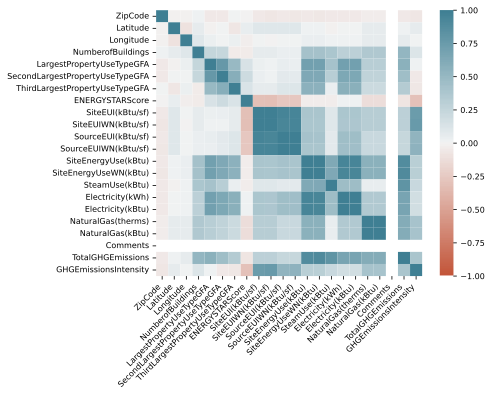

In [33]:
corr = data_extract.select_dtypes(include=['float']).corr()
plt.rcParams['font.size'] = 8
%config InlineBackend.figure_format = 'svg'
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

La consommation énergétique totale des bâtiments semblent être corrélée à : 
- Nombre de bâtiments ; 
- Nombre d'étage ; 
- Utilisation principale, secondaire et tertiaire (superficies) ; 
- Consommations d'énergies (intensité, autres sources, etc.)


Les émissions totales des GES semblent être corrélée à : 
- Nombre de bâtiments ; 
- Nombre d'étage ; 
- Utilisation principale, secondaire et tertiaire (superficies) ; 
- Consommations d'énergies (intensité, autres sources, etc.)


#### A) Données physiques

L'objectif est d'étudier et de sélectionner les données physiques d'intérêts.

Concernant les données physiques des bâtiments, les données peuvent être scindées en 2 catégories : 
- les données de superficie ; 
- les données d'architecture des bâtiments (nombre d'étages, nombre de bâtiments).

In [34]:
indic_physique = ['NumberofBuildings',
                    'NumberofFloors',
                    'PropertyGFABuilding(s)',
                    'PropertyGFAParking']

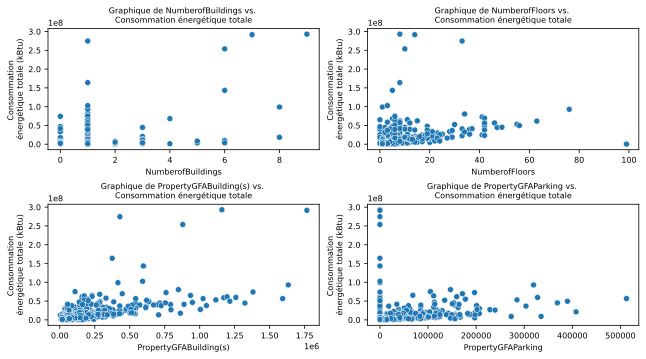

In [35]:
# Création du subplot avec 4 graphiques répartis sur 2 lignes et 2 colonnes
fig, axes = plt.subplots(2, 2, figsize=(9, 5))

# Conversion de l'axe des sous-graphiques en une liste à une dimension pour faciliter l'accès
axes = axes.flatten()

# Boucle pour tracer les graphiques
for i, features_stand in enumerate(indic_physique[:4]):
    # Tracer le graphique sur l'axe correspondant
    ax = axes[i]
    sns.scatterplot(data=data_extract, x=features_stand, y=indic_conso[0], ax=ax)
    ax.set_xlabel(features_stand, fontsize=8)
    ax.set_ylabel('Consommation \nénergétique totale (kBtu)', fontsize=8)
    ax.set_title(f'Graphique de {features_stand} vs. \nConsommation énergétique totale', fontsize=8)

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Affichage du subplot
plt.show()


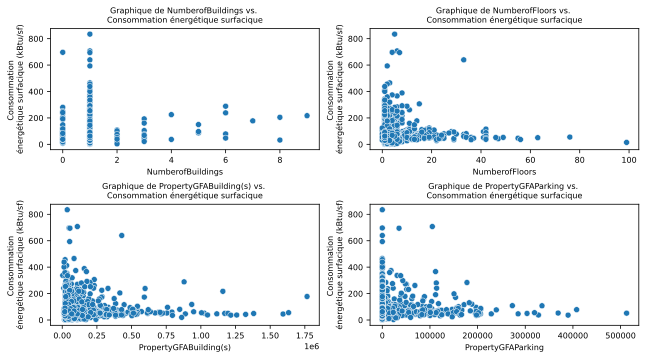

In [36]:
# Création du subplot avec 4 graphiques répartis sur 2 lignes et 2 colonnes
fig, axes = plt.subplots(2, 2, figsize=(9, 5))

# Conversion de l'axe des sous-graphiques en une liste à une dimension pour faciliter l'accès
axes = axes.flatten()

# Boucle pour tracer les graphiques
for i, features_stand in enumerate(indic_physique[:4]):
    # Tracer le graphique sur l'axe correspondant
    ax = axes[i]
    sns.scatterplot(data=data_extract, x=features_stand, y=indic_conso_intensite[0], ax=ax)
    ax.set_xlabel(features_stand, fontsize=8)
    ax.set_ylabel('Consommation \nénergétique surfacique (kBtu/sf)', fontsize=8)
    ax.set_title(f'Graphique de {features_stand} vs. \nConsommation énergétique surfacique', fontsize=8)

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Affichage du subplot
plt.show()


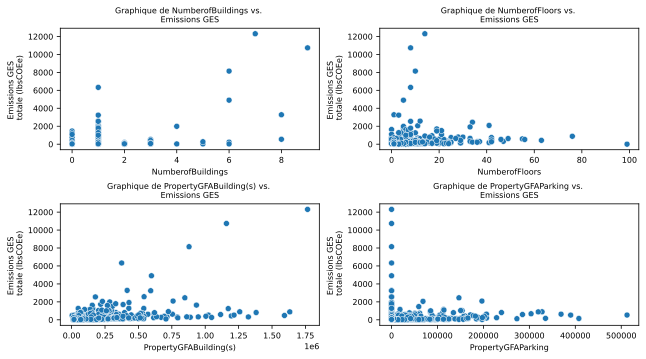

In [37]:
# Création du subplot avec 4 graphiques répartis sur 2 lignes et 2 colonnes
fig, axes = plt.subplots(2, 2, figsize=(9, 5))

# Conversion de l'axe des sous-graphiques en une liste à une dimension pour faciliter l'accès
axes = axes.flatten()

# Boucle pour tracer les graphiques
for i, features_stand in enumerate(indic_physique[:4]):
    # Tracer le graphique sur l'axe correspondant
    ax = axes[i]
    sns.scatterplot(data=data_extract, x=features_stand, y=indic_GES[0], ax=ax)
    ax.set_xlabel(features_stand, fontsize=8)
    ax.set_ylabel('Emissions GES \n totale (lbsCOEe)', fontsize=8)
    ax.set_title(f'Graphique de {features_stand} vs. \nEmissions GES', fontsize=8)

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Affichage du subplot
plt.show()


##### Superficie

L'objectif est de sélectionner les variables de superficie pertinentes pour le modèle.

In [38]:
data_extract['PropertyGFATotal - PropertyGFAParking'] = data_extract['PropertyGFATotal'] - data_extract['PropertyGFAParking']

<Axes: title={'center': 'PropertyGFATotal - PropertyGFAParking vs PropertyGFABuilding(s)'}, xlabel='PropertyGFATotal - PropertyGFAParking (sf)', ylabel='PropertyGFABuilding(s)(sf)'>

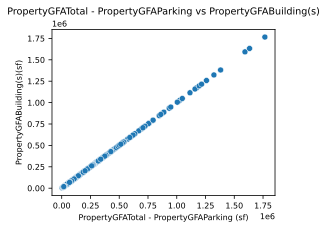

In [39]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('PropertyGFATotal - PropertyGFAParking (sf)')
plt.ylabel('PropertyGFABuilding(s)(sf)')
plt.title('PropertyGFATotal - PropertyGFAParking vs PropertyGFABuilding(s)')
sns.scatterplot(data = data_extract, x='PropertyGFATotal - PropertyGFAParking', y='PropertyGFABuilding(s)')

En effet, nous disposons de la superficie des bâtiments calculée en soustrayant 'PropertyGFAParking' de 'PropertyGFATotal'. 
Par conséquent, nous prendrons en compte les superficies de 'PropertyGFABuiladin(s)' et 'PropertyGFAParking', bien que les parkings puissent être moins explicatifs de la consommation énergétique (mais peut-être ceux qui sont chauffés ou climatisés en intérieur pourraient jouer un rôle).

<Axes: title={'center': 'Superficie des bâtiments vs SiteEnergyUse(kBtu)'}, xlabel='Superficie des bâtiments (sf)', ylabel='SiteEnergyUse(kBtu)'>

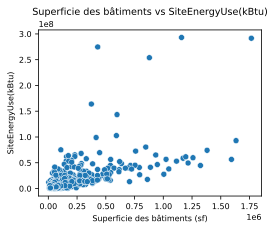

In [40]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('Superficie des bâtiments (sf)')
plt.ylabel('SiteEnergyUse(kBtu)')
plt.title('Superficie des bâtiments vs SiteEnergyUse(kBtu)')
sns.scatterplot(data = data_extract, x='PropertyGFABuilding(s)', y='SiteEnergyUse(kBtu)')

On remarque une consommation d'énergie totale avec l'augmentation de la superficie des bâtiments malgrès des valeurs abbérentes pour des bâtiments de petite taille.

##### Architecture

Concernant l'architecture des bâtiments les variable à disposition sont : 
- le nombre de bâtiments, 
- le nombre d'étages.

<Axes: xlabel='NumberofBuildings', ylabel='NumberofFloors'>

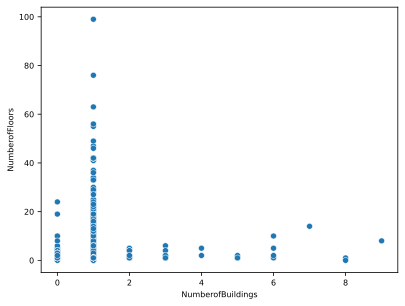

In [41]:
sns.scatterplot(data = data_extract, x='NumberofBuildings', y='NumberofFloors')

Il n'existe pas nécessairement de lien direct entre le nombre de bâtiments et le nombre d'étages des bâtiments. En effet, il est possible d'avoir des bâtiments avec peu d'étages, mais qui sont très dispersés, ainsi que des tours de grande hauteur. 

Cependant, nous pouvons formuler une hypothèse selon laquelle les bâtiments de grande hauteur et/ou dispersés pourraient être moins efficaces sur le plan énergétique. Cela peut s'expliquer par des facteurs tels que la nécessité d'une plus grande surface à chauffer, climatiser et éclairer, ainsi que la complexité de la gestion des systèmes de chauffage, de ventilation et de climatisation sur plusieurs étages. 

Par conséquent la création d'une variable calculant le ratio entre le nombre d'étages et le nombre de bâtiments pourrait être pertinant.Cette nouvelle caractéristique représente la densité d'étages par bâtiment. De plus, la densité d'étages par bâtiment varie considérablement d'un bâtiment à un autre. Certains bâtiments ont un grand nombre d'étages avec un seul bâtiment, tandis que d'autres peuvent avoir plusieurs bâtiments avec moins d'étages chacun.



In [42]:
data_extract['Densite_etage'] = data_extract['NumberofFloors'] / (data_extract['NumberofBuildings']+1)
# décage de 1 puisque les bâtiments de rez-de-chaussé sont indiqués par un nombre d'étage de 0

<Axes: title={'center': "Densité d'étage par bâtiment vs SiteEnergyUse(kBtu)"}, xlabel="Densité d'étage par bâtiment", ylabel='SiteEnergyUse(kBtu)'>

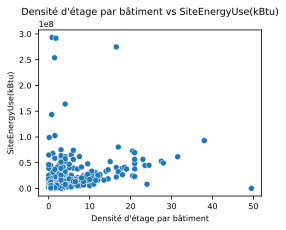

In [43]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('Densité d\'étage par bâtiment')
plt.ylabel('SiteEnergyUse(kBtu)')
plt.title('Densité d\'étage par bâtiment vs SiteEnergyUse(kBtu)')
sns.scatterplot(data = data_extract, x='Densite_etage', y='SiteEnergyUse(kBtu)')

La densité d'étages par bâtiment peut avoir un impact sur la consommation énergétique. Par exemple, un bâtiment avec plusieurs étages et un seul bâtiment peut nécessiter une ventilation, un système de chauffage ou de refroidissement plus efficace pour desservir l'ensemble du bâtiment, ce qui peut influencer la consommation énergétique. Pour autant des bâtiments plus étalés peuvent induire à plus perte et une efficacité energétique plus faible. 

En somme les features correspondant aux caractéristiques physiques sélectionnés sont : 
- 'PropertyGFABuilding(s)'
- 'PropertyGFAParking'
- 'Densite_etage'

In [44]:
# features "physique" sélectionnées
indic_physique = ['PropertyGFABuilding(s)',
                    'PropertyGFAParking',
                    'Densite_etage',
                    ]

In [45]:
data_extract[indic_physique].describe()

,PropertyGFABuilding(s),PropertyGFAParking,Densite_etage
count,1.476000e+03,1476.000000,1476.000000
mean,9.855650e+04,14245.642276,2.195381
std,1.667536e+05,44525.035195,3.504821
min,3.636000e+03,0.000000,0.000000
25%,2.790000e+04,0.000000,0.500000
50%,4.585300e+04,0.000000,1.000000
75%,9.356875e+04,0.000000,2.500000
max,1.765970e+06,512608.000000,49.500000


#### B) Âge des bâtiments

La variable 'âge' des bâtiments est caclulée en prenant en compte la date de construction des bâtiments, 

In [46]:
data_extract['Age']= 2023 - data_extract['YearBuilt']
data_extract['Age'].head()

0    96
1    27
2    54
3    97
4    43
Name: Age, dtype: int64

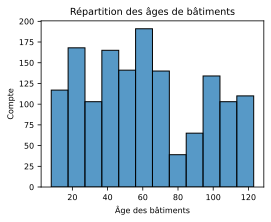

In [48]:
plt.figure(figsize=(4, 3)) 

# Création du graphique de la répartition de la variable
sns.histplot(data_extract['Age'])
plt.xlabel('Âge des bâtiments')
plt.ylabel('Compte')
plt.title('Répartition des âges de bâtiments')

plt.show()

Il n'y a pas d'asymétrie dans la distribution de l'âge des bâtiments, même si on remarque une baisse de la construction de bâtiments durant la seconde guerre mondiale.

<Axes: title={'center': 'SiteEnergyUse(kBtu) par âge des bâtiments'}, xlabel='Age des bâtiments', ylabel='SiteEnergyUse(kBtu)'>

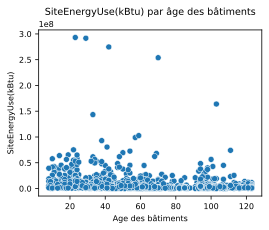

In [49]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('Age des bâtiments')
plt.ylabel('SiteEnergyUse(kBtu)')
plt.title('SiteEnergyUse(kBtu) par âge des bâtiments')
sns.scatterplot(data = data_extract, x='Age', y='SiteEnergyUse(kBtu)')

<Axes: title={'center': 'TotalGHGEmissions par âge des bâtiments'}, xlabel='Age des bâtiments', ylabel='TotalGHGEmissions (lbs CO2 e)'>

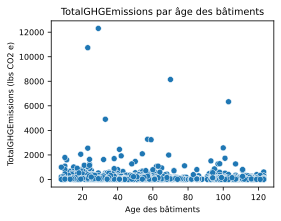

In [50]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('Age des bâtiments')
plt.ylabel('TotalGHGEmissions (lbs CO2 e)')
plt.title('TotalGHGEmissions par âge des bâtiments')
sns.scatterplot(data = data_extract, x='Age', y='TotalGHGEmissions')

Contrairement à ce que l'on pourrait penser, il n'existe pas de corrélation directe entre l'âge des bâtiments et leur consommation énergétique ainsi que leurs émissions de gaz à effet de serre. Il semblerait que d'autres facteurs entrent en jeu de manière plus significative pour expliquer ces variations.

In [51]:
indic_age =['Age']

##### C) Utilisation des bâtiments

Concernant l'utilisation des batiments les données concernant le type d'utilisation et la superficie d'utilisation de 3 premiers usages sont disponibles. 

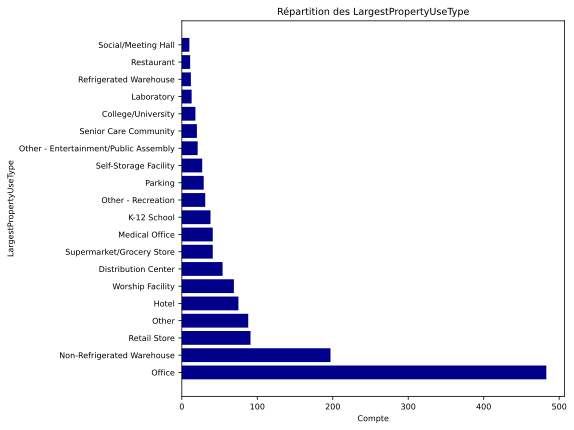

In [52]:
# Obtenir les 20 classes avec les plus grands effectifs
top_20_classes = data_extract['LargestPropertyUseType'].value_counts().head(20).reset_index()

# Création du graphique à barres horizontales
plt.figure(figsize=(8, 6))  
plt.barh(top_20_classes['LargestPropertyUseType'], top_20_classes['count'], color='darkblue')
plt.xlabel('Compte')
plt.ylabel('LargestPropertyUseType')
plt.title('Répartition des LargestPropertyUseType')

plt.tight_layout()  

plt.show()

Les bureaux et les entrepots ont les effictifs de bâtiment les plus élevés.

*Consommation énegertique totale*

In [53]:
conso_per_usage = data_extract.groupby(['LargestPropertyUseType']).agg({'SiteEnergyUse(kBtu)': 'mean'})
conso_per_usage.sort_values(by='SiteEnergyUse(kBtu)', ascending=False, inplace=True)
conso_per_usage.head(n=15)

,SiteEnergyUse(kBtu)
LargestPropertyUseType,
Hospital (General Medical & Surgical),1.415470e+08
Data Center,1.154671e+08
Courthouse,4.498447e+07
Laboratory,2.736661e+07
Urgent Care/Clinic/Other Outpatient,2.527676e+07
Lifestyle Center,1.952247e+07
Parking,1.530626e+07
Other - Mall,1.525270e+07
Wholesale Club/Supercenter,1.342408e+07


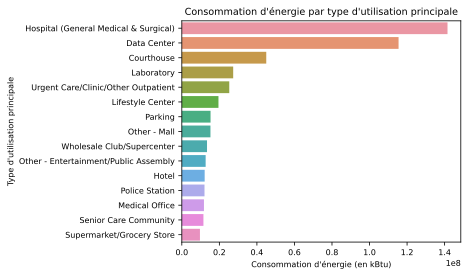

In [54]:
# Extraction des données pour le graphe
plt.figure(figsize=(5, 4)) 
conso_values = conso_per_usage['SiteEnergyUse(kBtu)'].head(n=15)
usage_types = conso_values.index

sns.barplot(x=conso_values, y=usage_types)

plt.xlabel("Consommation d'énergie (en kBtu)")
plt.ylabel("Type d'utilisation principale")
plt.title("Consommation d'énergie par type d'utilisation principale")

plt.show()

In [55]:
conso_per_usage = data_extract.groupby(['SecondLargestPropertyUseType']).agg({'SiteEnergyUse(kBtu)': 'mean'})
conso_per_usage.sort_values(by='SiteEnergyUse(kBtu)', ascending=False, inplace=True)
conso_per_usage.head(n=15)

,SiteEnergyUse(kBtu)
SecondLargestPropertyUseType,
Hospital (General Medical & Surgical),4.258403e+07
Refrigerated Warehouse,2.297545e+07
Laboratory,1.999211e+07
Data Center,1.882322e+07
College/University,1.810203e+07
Swimming Pool,1.788949e+07
Other - Recreation,1.613014e+07
Parking,1.480975e+07
Courthouse,1.307170e+07


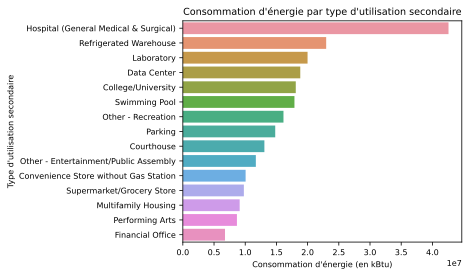

In [56]:
# Extraction des données pour le graphe
plt.figure(figsize=(5, 4)) 
conso_values = conso_per_usage['SiteEnergyUse(kBtu)'].head(n=15)
usage_types = conso_values.index

sns.barplot(x=conso_values, y=usage_types)

plt.xlabel("Consommation d'énergie (en kBtu)")
plt.ylabel("Type d'utilisation secondaire")
plt.title("Consommation d'énergie par type d'utilisation secondaire")

plt.show()

In [57]:
conso_per_usage = data_extract.groupby(['ThirdLargestPropertyUseType']).agg({'SiteEnergyUse(kBtu)': 'mean'})
conso_per_usage.sort_values(by='SiteEnergyUse(kBtu)', ascending=False, inplace=True)
conso_per_usage.head(n=15)

,SiteEnergyUse(kBtu)
ThirdLargestPropertyUseType,
Other/Specialty Hospital,1.026737e+08
Hotel,3.940332e+07
Financial Office,3.365022e+07
Convenience Store without Gas Station,2.995884e+07
Other - Technology/Science,2.631235e+07
Worship Facility,2.062868e+07
Laboratory,2.041966e+07
Other,2.005237e+07
Swimming Pool,1.515642e+07


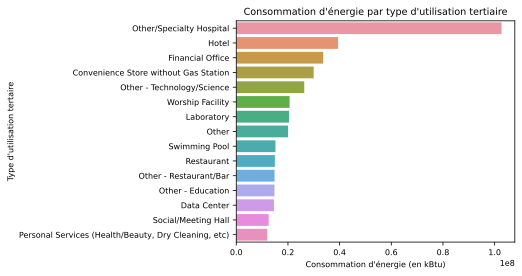

In [58]:
# Extraction des données pour le graphe
plt.figure(figsize=(5, 4)) 
conso_values = conso_per_usage['SiteEnergyUse(kBtu)'].head(n=15)
usage_types = conso_values.index

sns.barplot(x=conso_values, y=usage_types)

plt.xlabel("Consommation d'énergie (en kBtu)")
plt.ylabel("Type d'utilisation tertaire")
plt.title("Consommation d'énergie par type d'utilisation tertiaire")

plt.show()

Il existe des différences significatives de consommation totale moyenne d'énergie en fonction du type d'utilisation principale des bâtiments. Les hôpitaux ont tendance à avoir une consommation plus élevée en raison de leur grande superficie et de la nécessité de fournir des services médicaux 24 heures sur 24. Les data centers, quant à eux, sont connus pour leur intensité énergétique élevée en raison des besoins de refroidissement et de la gestion des serveurs informatiques.

En ce qui concerne les utilisations secondaires ou tertiaires, leur consommation d'énergie semble inférieure à celle des utilisations principales, car ces bâtiments peuvent avoir des fonctions plus spécifiques ou des horaires d'exploitation limités. Il est également possible que certaines utilisations principales énergivores ne soient pas présentes dans les utilisations secondaires ou tertiaires (ex: Data Center), ce qui peut expliquer les différences de consommation d'énergie.

*Consommation énegertique surfacique*

In [59]:
conso_per_usage = data_extract.groupby(['LargestPropertyUseType']).agg({'SiteEUI(kBtu/sf)': 'mean'})
conso_per_usage.sort_values(by='SiteEUI(kBtu/sf)', ascending=False, inplace=True)
conso_per_usage.head(n=15)

,SiteEUI(kBtu/sf)
LargestPropertyUseType,
Data Center,722.933350
Urgent Care/Clinic/Other Outpatient,289.674995
Laboratory,257.415387
Supermarket/Grocery Store,232.607319
Hospital (General Medical & Surgical),197.009999
Restaurant,194.018184
Other/Specialty Hospital,165.300003
Museum,153.440001
Other - Restaurant/Bar,148.199997


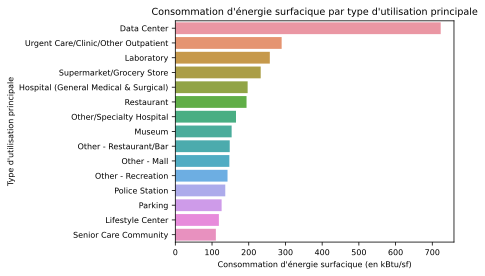

In [60]:
# Extraction des données pour le graphe
plt.figure(figsize=(5, 4)) 
conso_values = conso_per_usage['SiteEUI(kBtu/sf)'].head(n=15)
usage_types = conso_values.index

sns.barplot(x=conso_values, y=usage_types)

plt.xlabel("Consommation d'énergie surfacique (en kBtu/sf)")
plt.ylabel("Type d'utilisation principale")
plt.title("Consommation d'énergie surfacique par type d'utilisation principale")

plt.show()

Il existe des différences significatives de consommation surfacique moyenne d'énergie en fonction du type d'utilisation principale des bâtiments. Les data centers ont la consommation surfacique la plus élevée, ce qui est cohérent avec leur intensité énergétique élevée mentionnée précédemment. Ils nécessitent une grande quantité d'énergie pour alimenter leurs équipements informatiques et de refroidissement.

D'autres utilisations telles que les cliniques, les laboratoires, les supermarchés et les hôpitaux ont également des consommations surfaciques d'énergie relativement élevées. Cela peut s'expliquer par leurs besoins spécifiques en équipements médicaux, en réfrigération, en éclairage et en climatisation.

D'un autre côté, les utilisations comme les musées, les restaurants et les centres de style de vie ont des consommations surfaciques d'énergie relativement plus faibles. Ces types de bâtiments peuvent avoir des besoins énergétiques moins importants en raison de leur taille plus réduite et de leurs activités spécifiques.

*Emissions de GES*

In [61]:
conso_per_usage = data_extract.groupby(['LargestPropertyUseType']).agg({'TotalGHGEmissions': 'mean'})
conso_per_usage.sort_values(by='TotalGHGEmissions', ascending=False, inplace=True)
conso_per_usage.head(n=15)

,TotalGHGEmissions
LargestPropertyUseType,
Hospital (General Medical & Surgical),5052.963000
Courthouse,1265.290000
Laboratory,815.766154
Data Center,807.266667
Lifestyle Center,539.965000
Urgent Care/Clinic/Other Outpatient,512.062500
Hotel,391.040267
Senior Care Community,371.899500
Police Station,301.810000


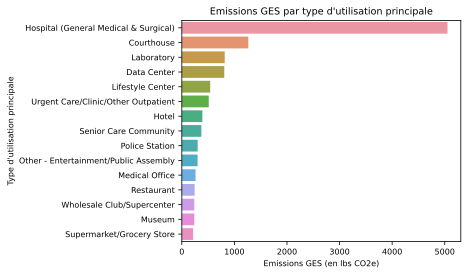

In [62]:
# Extraction des données pour le graphe
plt.figure(figsize=(5, 4)) 
conso_values = conso_per_usage['TotalGHGEmissions'].head(n=15)
usage_types = conso_values.index

sns.barplot(x=conso_values, y=usage_types)

plt.xlabel("Emissions GES (en lbs CO2e)")
plt.ylabel("Type d'utilisation principale")
plt.title("Emissions GES par type d'utilisation principale")

plt.show()

Lorsque l'on compare les émissions totales de GES aux consommations énergétiques précédemment mentionnées, certaines tendances intéressantes se dégagent.

Les hôpitaux, qui ont été identifiés comme ayant une consommation d'énergie élevée, présentent également des émissions de GES élevées. Cela peut s'expliquer par le fait que les hôpitaux ont souvent une empreinte carbone importante en raison de l'utilisation de technologies médicales, de systèmes de chauffage, de ventilation et de climatisation complexes, ainsi que de l'approvisionnement en énergie de secours.

Les data centers, bien qu'ils aient une consommation d'énergie élevée par unité de surface, ont des émissions de GES relativement plus faibles. Cela peut être dû à l'utilisation de sources d'énergie plus propres et à des pratiques d'efficacité énergétique améliorées dans ces installations.

Les données relatives aux émissions des cours de justice sont surprenantes car elles révèlent une consommation énergétique relativement faible par rapport à leurs émissions de GES. Cela suggère que ces établissements pourraient utiliser des sources d'énergie qui ont un fort impact sur les émissions de gaz à effet de serre. Il est possible qu'ils dépendent de sources d'énergie fortement émettrices, telles que des combustibles fossiles non renouvelables.

### D) Données géographiques

*Consomation énergétique totale*

In [63]:
indic_geo = ['Latitude', 'Longitude']
data_extract_carto = data [indic_conso + indic_geo]
data_extract_carto = data_extract_carto.sort_values(by=[indic_conso][0], ascending=False)
data_extract_carto = data_extract_carto.dropna(axis =0, how='any')

In [64]:
latitude_initiale = data_extract_carto['Latitude'][0]
longitude_initiale = data_extract_carto['Longitude'][0]

In [65]:
# echelle de couleur en quantile 
# Calcul des quantiles
quantiles = np.quantile(data_extract_carto['SiteEnergyUse(kBtu)'], [0.25, 0.5, 0.75, 0.9])

# Création de l'échelle de couleurs basée sur les quantiles
colormap = cm.LinearColormap(colors=['green', 'yellow', 'orange', 'red'], vmin=quantiles[0], vmax=quantiles[-1], index=quantiles, caption='Consommation énergétique')

# Création de la carte
map = folium.Map(location=[latitude_initiale, longitude_initiale], zoom_start=12)

# Parcours des données et ajout des marqueurs à la carte
for index, row in data_extract_carto.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    consommation = row['SiteEnergyUse(kBtu)']
    tooltip = row['SiteEnergyUse(kBtu)']
    color = colormap(consommation)
    marker = folium.CircleMarker([lat, lon], tooltip=tooltip, fill=False, color=color, fill_opacity=0.7, radius=5)
    marker.add_to(map)

# Ajout de la légende de couleurs
colormap.add_to(map)

# Affichage de la carte
map


In [66]:
# mettre en majuscule les données de quartiers pour homogéneiser
data['Neighborhood'] = data['Neighborhood'].str.capitalize()
data_extract['Neighborhood'] = data_extract['Neighborhood'].str.capitalize()

In [67]:
# correction d'une erreur de saisie des quartiers
data.loc[data['Neighborhood'] == 'Delridge neighborhoods', 'Neighborhood'] = 'Delridge'
data_extract.loc[data_extract['Neighborhood'] == 'Delridge neighborhoods','Neighborhood'] = 'Delridge'


In [68]:
mean_conso_by_neighborhood = data.groupby('Neighborhood')[indic_conso].mean()
mean_conso_by_neighborhood = mean_conso_by_neighborhood.sort_values(by = indic_conso[0],ascending=False)
mean_conso_by_neighborhood

,SiteEnergyUse(kBtu)
Neighborhood,
Downtown,9.530603e+06
Northeast,7.597919e+06
Lake union,6.821918e+06
East,5.557689e+06
Greater duwamish,4.930060e+06
Delridge,3.723864e+06
Central,3.646028e+06
Northwest,3.527870e+06
Ballard,3.421627e+06


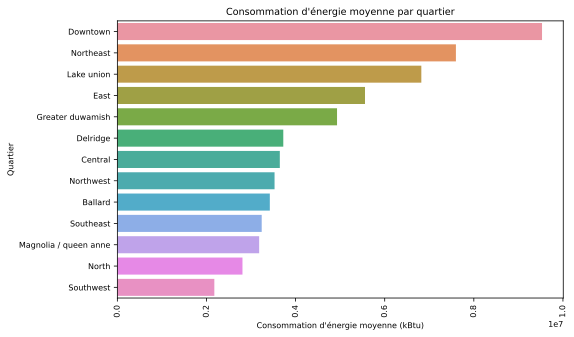

In [69]:
# Création du graphe avec Seaborn
plt.figure(figsize=(8,5))
sns.barplot(y=mean_conso_by_neighborhood.index, x=mean_conso_by_neighborhood[indic_conso[0]], orient="h")
plt.xticks(rotation=90)
plt.ylabel('Quartier')
plt.xlabel('Consommation d\'énergie moyenne (kBtu)')
plt.title('Consommation d\'énergie moyenne par quartier')

# Affichage du graphe
plt.show()

In [70]:
indic_geo = ['Latitude', 'Longitude', 'Neighborhood']
data_extract_carto = data [indic_geo]
data_extract_carto = data_extract_carto.dropna(axis =0, how='any')
data_extract_carto.head()


,Latitude,Longitude,Neighborhood
0,47.61220,-122.33799,Downtown
1,47.61317,-122.33393,Downtown
2,47.61393,-122.33810,Downtown
3,47.61412,-122.33664,Downtown
4,47.61375,-122.34047,Downtown


In [71]:
latitude_initiale = data_extract_carto['Latitude'][0]
longitude_initiale = data_extract_carto['Longitude'][0]

In [72]:
# Définition des valeurs de consommation énergétique pour chaque point
quartiers = data_extract_carto['Neighborhood'].unique()

# Couleurs
couleurs = ['red', 
            'blue', 
            'green', 
            'yellow', 
            'orange',
            'purple', 
            'pink', 
            'turquoise', 
            'brown', 
            'gray', 
            'black',
            'white', 
            'gold', 
            'silver']

# Carte

map = folium.Map(location=[latitude_initiale, longitude_initiale], zoom_start=12)

# Parcou des données géographiques et ajout des marqueurs à la carte 
for index, row in data_extract_carto.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    tooltip = row['Neighborhood'] 
    color = couleurs[quartiers.tolist().index(row['Neighborhood'])] 
    marker = folium.CircleMarker([lat, lon], tooltip=tooltip, fill=True, color=color, fill_opacity=0.7, radius=4)
    marker.add_to(map)

# Création de la légende
legend_html = '<div style="position:fixed; bottom:50px; right:50px; z-index:100; background:white; padding:10px; border:1px solid grey;">'
for quartier, couleur in zip(quartiers, couleurs):
    legend_html += f'<div style="margin-bottom:5px;"><span style="background:{couleur}; width:12px; height:12px; display:inline-block; margin-right:5px;"></span>{quartier}</div>'
legend_html += '</div>'

map.get_root().html.add_child(folium.Element(legend_html))

map

Il semble y avoir des quartiers avec une consommation totale plus importante que d'autres. La variation de la consommation énergétique moyenne des bâtiments entre les quartiers de Seattle pourrait s'expliquer par plusieurs facteurs :
- Densité de population : Les quartiers plus densément peuplés peuvent avoir une consommation d'énergie moyenne plus élevée en raison du plus grand nombre de bâtiments résidentiels et commerciaux.
- Types de bâtiments : Certains quartiers peuvent avoir une prédominance de certains types de bâtiments, tels que des immeubles de bureaux, des résidences, des commerces ou des installations industrielles. Chaque type de bâtiment peut avoir des besoins énergétiques spécifiques qui contribuent à la variation de la consommation moyenne.
- Âge des bâtiments : Les quartiers qui ont des bâtiments plus anciens peuvent avoir une consommation d'énergie moyenne plus élevée en raison de l'efficacité énergétique inférieure de ces bâtiments par rapport aux constructions plus récentes.
- Facteurs socio-économiques : Les différences socio-économiques entre les quartiers peuvent également influencer la consommation d'énergie moyenne des bâtiments. Par exemple, les quartiers plus aisés peuvent avoir des habitations plus grandes et des équipements plus énergivores.
- Politiques et initiatives locales : Certains quartiers peuvent être plus engagés dans des initiatives de développement durable et d'efficacité énergétique, ce qui peut conduire à une consommation d'énergie moyenne plus faible.

*Consomation énergétique surfacique*

In [73]:
indic_geo = ['Latitude', 'Longitude']
data_extract_carto = data [indic_conso_intensite + indic_geo]
data_extract_carto = data_extract_carto.sort_values(by=[indic_conso_intensite][0], ascending=False)
data_extract_carto = data_extract_carto.dropna(axis =0, how='any')

In [74]:
latitude_initiale = data_extract_carto['Latitude'][0]
longitude_initiale = data_extract_carto['Longitude'][0]

In [75]:
# echelle de couleur en quantile 
# Calcul des quantiles
quantiles = np.quantile(data_extract_carto[indic_conso_intensite[0]], [0.25, 0.5, 0.75, 0.9])

# Création de l'échelle de couleurs basée sur les quantiles
colormap = cm.LinearColormap(colors=['green', 'yellow', 'orange', 'red'], vmin=quantiles[0], vmax=quantiles[-1], index=quantiles, caption='Consommation énergétique')

# Création de la carte
map = folium.Map(location=[latitude_initiale, longitude_initiale], zoom_start=12)

# Parcours des données et ajout des marqueurs à la carte
for index, row in data_extract_carto.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    consommation = row[indic_conso_intensite[0]]
    tooltip = row[indic_conso_intensite[0]]
    color = colormap(consommation)
    marker = folium.CircleMarker([lat, lon], tooltip=tooltip, fill=False, color=color, fill_opacity=0.7, radius=5)
    marker.add_to(map)

# Ajout de la légende de couleurs
colormap.add_to(map)

# Affichage de la carte
map


In [76]:
mean_conso_by_neighborhood = data.groupby('Neighborhood')[indic_conso_intensite].mean()
mean_conso_by_neighborhood = mean_conso_by_neighborhood.sort_values(by = indic_conso_intensite[0],ascending=False)
mean_conso_by_neighborhood

,SiteEUI(kBtu/sf)
Neighborhood,
Lake union,66.690040
Downtown,65.121892
Northeast,58.444964
Ballard,56.316541
East,54.104194
Delridge,53.224706
Central,50.620149
Greater duwamish,50.328000
Magnolia / queen anne,49.879147


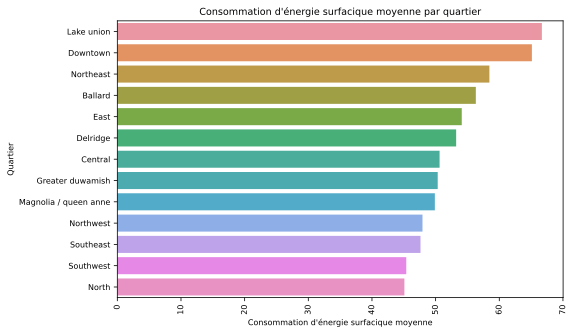

In [77]:
# Création du graphe avec Seaborn
plt.figure(figsize=(8,5))
sns.barplot(y=mean_conso_by_neighborhood.index, x=mean_conso_by_neighborhood[indic_conso_intensite[0]], orient="h")
plt.xticks(rotation=90)
plt.ylabel('Quartier')
plt.xlabel('Consommation d\'énergie surfacique moyenne')
plt.title('Consommation d\'énergie surfacique moyenne par quartier')

# Affichage du graphe
plt.show()

Globalement, les consommations totales d'énergie et les consommations surfaciques par quartiers sont cohérentes pour les quartiers. 

*Emissions de GES*

In [78]:
indic_geo = ['Latitude', 'Longitude']
data_extract_carto = data [indic_GES + indic_geo]
data_extract_carto = data_extract_carto.sort_values(by=[indic_GES][0], ascending=False)
data_extract_carto = data_extract_carto.dropna(axis =0, how='any')

In [79]:
latitude_initiale = data_extract_carto['Latitude'][0]
longitude_initiale = data_extract_carto['Longitude'][0]

In [80]:
# echelle de couleur en quantile 
# Calcul des quantiles
quantiles = np.quantile(data_extract_carto[indic_GES[0]], [0.25, 0.5, 0.75, 0.9])

# Création de l'échelle de couleurs basée sur les quantiles
colormap = cm.LinearColormap(colors=['green', 'yellow', 'orange', 'red'], vmin=quantiles[0], vmax=quantiles[-1], index=quantiles, caption='Consommation énergétique')

# Création de la carte
map = folium.Map(location=[latitude_initiale, longitude_initiale], zoom_start=12)

# Parcours des données et ajout des marqueurs à la carte
for index, row in data_extract_carto.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    consommation = row[indic_GES[0]]
    tooltip = row[indic_GES[0]]
    color = colormap(consommation)
    marker = folium.CircleMarker([lat, lon], tooltip=tooltip, fill=False, color=color, fill_opacity=0.7, radius=5)
    marker.add_to(map)

# Ajout de la légende de couleurs
colormap.add_to(map)

# Affichage de la carte
map


In [81]:
mean_conso_by_neighborhood = data.groupby('Neighborhood')[indic_GES].mean()
mean_conso_by_neighborhood = mean_conso_by_neighborhood.sort_values(by = indic_GES[0],ascending=False)
mean_conso_by_neighborhood

,TotalGHGEmissions
Neighborhood,
Downtown,182.362622
East,176.406504
Northeast,143.024874
Lake union,134.885538
Greater duwamish,112.507680
Central,93.079254
Northwest,84.310318
Ballard,82.049850
Southeast,75.656737


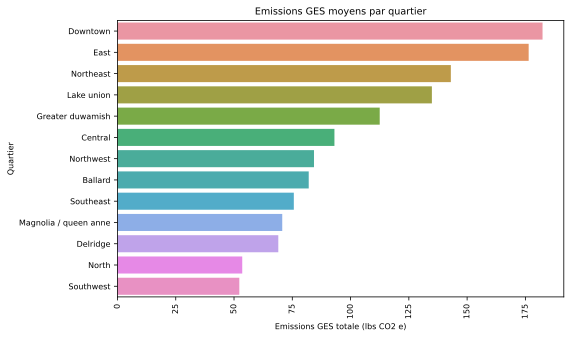

In [82]:
# Création du graphe avec Seaborn
plt.figure(figsize=(8,5))
sns.barplot(y=mean_conso_by_neighborhood.index, x=mean_conso_by_neighborhood[indic_GES[0]], orient="h")
plt.xticks(rotation=90)
plt.ylabel('Quartier')
plt.xlabel('Emissions GES totale (lbs CO2 e)')
plt.title('Emissions GES moyens par quartier')

# Affichage du graphe
plt.show()

L'analyse des émissions totales de GES par quartier en relation avec les consommations totales d'énergie et les consommations surfaciques révèle certaines tendances intéressantes.

On observe que les quartiers avec les consommations totales d'énergie les plus élevées, tels que Downtown, East, Northeast et Lake Union, affichent également des émissions totales de GES plus élevées. Cela suggère une corrélation positive entre la consommation d'énergie et les émissions de GES dans ces quartiers.

En revanche, certains quartiers se démarquent en termes d'émissions de GES par unité de surface. Par exemple, Downtown, East et Northeast, qui présentent des consommations surfaciques relativement élevées, affichent également des émissions de GES élevées. Cela peut être dû à la présence de bâtiments plus grands ou à des activités spécifiques qui contribuent à des émissions de GES plus importantes.

Il est intéressant de noter que certains quartiers, tels que Central, Northwest et Ballard, ont des consommations surfaciques relativement faibles mais affichent néanmoins des émissions de GES significatives. Cela peut être dû à d'autres facteurs influençant les émissions de GES, tels que le mix energétique utilisé dans ces quartiers.

### E) Mix énergétique des bâtiments

Le mix énergétique est seulement utilisé en lien avec les émissions de GES.

In [83]:
indic_mix_energy = ['Electricity(kBtu)',
                    'NaturalGas(kBtu)',
                    'SteamUse(kBtu)',
                    ]

Le mix énergétique initial est déterminé en utilisant les valeurs de référence de l'année 1 du benchmark.

In [84]:
indic_mix_energy = ['Pourc_elec',
                    'Pourc_gas',
                    'Pourc_steam',
                    ]

In [85]:
data_extract['Pourc_elec'] = data_extract['Electricity(kBtu)'] / data_extract['SiteEnergyUse(kBtu)']
data_extract['Pourc_gas'] = data_extract['NaturalGas(kBtu)'] / data_extract['SiteEnergyUse(kBtu)'] 
data_extract['Pourc_steam'] = data_extract['SteamUse(kBtu)'] / data_extract['SiteEnergyUse(kBtu)']

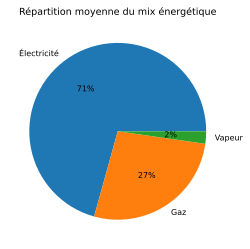

In [86]:
# Calcul de la moyenne de la consommation pour chaque source d'énergie
moyenne_electricite = data_extract['Pourc_elec'].mean()
moyenne_gaz = data_extract['Pourc_gas'].mean()
moyenne_vapeur = data_extract['Pourc_steam'].mean()

# Création d'un DataFrame pour les données
data = {
    'Source d\'énergie': ['Électricité', 'Gaz', 'Vapeur'],
    'Moyenne de consommation': [moyenne_electricite, moyenne_gaz, moyenne_vapeur]
}
df = pd.DataFrame(data)

# Création du graphique camembert avec Seaborn
plt.figure(figsize=(4, 4))
plt.title("Répartition moyenne du mix énergétique")
plt.pie(data=df, x='Moyenne de consommation', labels='Source d\'énergie', autopct='%1.0f%%')

# Affichage du graphique
plt.show()

En analysant le mix énergétique moyen des bâtiments, on constate qu'il est principalement composé d'électricité, représentant environ 71% de la consommation totale. Le gaz naturel constitue la deuxième source d'énergie la plus utilisée, représentant environ 27% de la consommation. Enfin, la vapeur représente une petite part de seulement 2,3%.

Cette répartition du mix énergétique met en évidence une dépendance significative à l'électricité pour répondre aux besoins énergétiques des bâtiments. Cela peut être dû à l'utilisation de l'électricité pour l'éclairage, le chauffage, la climatisation, les équipements électroniques, etc. Le gaz naturel est également utilisé de manière substantielle, probablement pour le chauffage, l'eau chaude sanitaire et d'autres applications nécessitant une source de chaleur.

La présence de la vapeur, bien que représentant une petite part, suggère que certains bâtiments peuvent avoir des systèmes de chauffage ou de production d'énergie plus complexes qui utilisent la vapeur comme source de chaleur.

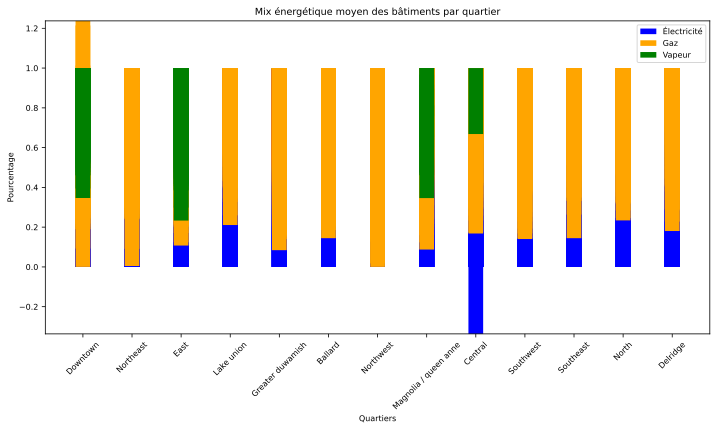

In [87]:
# Création du graphique
fig, ax = plt.subplots(figsize=(10, 6))

# Barres du graphique
bar_width = 0.3
quartiers = data_extract['Neighborhood']
pourc_elec = data_extract['Pourc_elec']
pourc_gas = data_extract['Pourc_gas']
pourc_steam = data_extract['Pourc_steam']

bar1 = ax.bar(quartiers, pourc_elec, width=bar_width, label='Électricité', color='blue')
bar2 = ax.bar(quartiers, pourc_gas, width=bar_width, label='Gaz', color='orange', bottom=pourc_elec)
bar3 = ax.bar(quartiers, pourc_steam, width=bar_width, label='Vapeur', color='green', bottom=pourc_elec + pourc_gas)

# Légendes et titres
ax.set_xlabel('Quartiers')
ax.set_ylabel('Pourcentage')
ax.set_title('Mix énergétique moyen des bâtiments par quartier')
ax.legend()

# Affichage du graphique
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

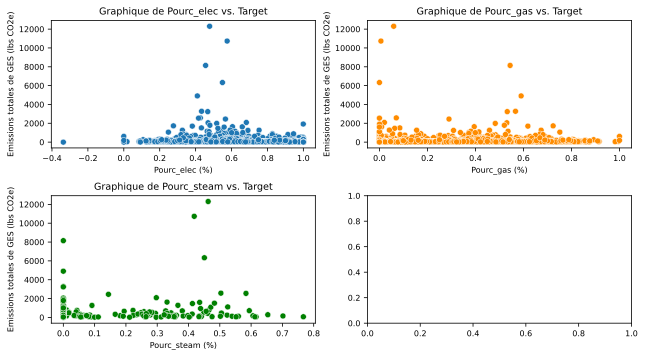

In [88]:
# Création du subplot avec 4 graphiques répartis sur 2 lignes et 2 colonnes
fig, axes = plt.subplots(2, 2, figsize=(9, 5))

# Conversion de l'axe des sous-graphiques en une liste à une dimension pour faciliter l'accès
axes = axes.flatten()

# Boucle pour tracer les graphiques
for i, features_stand in enumerate(indic_mix_energy[:4]):
    # Tracer le graphique sur l'axe correspondant
    ax = axes[i]
    if i == 1:
        sns.scatterplot(data=data_extract, x=features_stand, y=indic_GES[0], ax=ax, color='#FF8C00')
    elif i == 2:
        sns.scatterplot(data=data_extract, x=features_stand, y=indic_GES[0], ax=ax, color='green')
    else:
        sns.scatterplot(data=data_extract, x=features_stand, y=indic_GES[0], ax=ax)
    ax.set_xlabel(features_stand +' (%)')
    ax.set_ylabel('Emissions totales de GES (lbs CO2e)')
    ax.set_title(f'Graphique de {features_stand} vs. Target')

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Affichage du subplot
plt.show()

### F) Energy Star Score

L'EnergyStarScore est une note de 1 à 100 calculée par l'EPA qui évalue la performance énergétique globale d'un bien immobilier, sur la base de données nationales afin de contrôler les différences de climat, d'utilisation des bâtiments et d'exploitation. Une note de 50 représente la médiane nationale. 

In [89]:
data_extract['ENERGYSTARScore'].describe()

count    961.000000
mean      63.390219
std       28.865613
min        1.000000
25%       43.000000
50%       70.000000
75%       88.000000
max      100.000000
Name: ENERGYSTARScore, dtype: float64

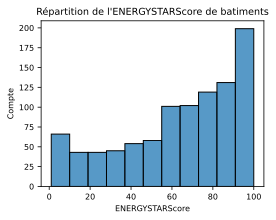

In [90]:
plt.figure(figsize=(4, 3)) 

# Création du graphique de la répartition de la variable
sns.histplot(data_extract['ENERGYSTARScore'])
plt.xlabel('ENERGYSTARScore')
plt.ylabel('Compte')
plt.title('Répartition de l\'ENERGYSTARScore de batiments')

plt.show()

<Axes: title={'center': 'TotalGHGEmissions en fonction desENERGYSTARScore'}, xlabel='ENERGYSTARScore', ylabel='TotalGHGEmissions (lbs CO2e)'>

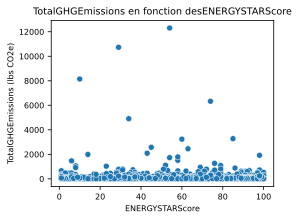

In [91]:
plt.figure(figsize=(4, 3)) 
plt.xlabel('ENERGYSTARScore')
plt.ylabel('TotalGHGEmissions (lbs CO2e)')
plt.title('TotalGHGEmissions en fonction desENERGYSTARScore')
sns.scatterplot(data = data_extract, x='ENERGYSTARScore', y='TotalGHGEmissions')

Il semble y avoir une corrélation négative entre l'ENERGYSTARScore et les émissions totales de GES: des scores ENERGYSTAR plus élevés sont généralement associés à des émissions de gaz à effet de serre plus faibles. 
Pour autant on remarque des valeurs aberrantes qui sont des bâtiments avec des scores ENERGYSTAR élevés mais des émissions de gaz à effet de serre relativement élevées. Cela pourrait indiquer des inefficacités, des mixs énegrétiques polluants ou des problèmes spécifiques dans ces bâtiments.

In [92]:
# Export du DataFrame au format CSV
data_extract.to_csv('data_extract.csv', index=False)